# Audio Processing: Week 2 – Loudness, Normalization & Dynamics Processing

Minggu ini kita akan fokus pada kontrol amplitudo: mengukur loudness, normalisasi audio, dan dynamics processing.

## Tujuan Pembelajaran:

- **Memahami konsep fundamental** *loudness*: Peak, RMS, dan LUFS
- **Mengukur *loudness* audio** menggunakan NumPy dan pustaka `pyloudnorm`
- **Menerapkan kontrol volume** *fade in/out* dan *crossfade* untuk transisi
- **Menguasai *dynamics processing*** kompresor dan *noise gate*
- **Mendeteksi dan memotong** bagian hening (*silence*) secara otomatis
- **Membangun rantai pemrosesan** audio lengkap

## Aplikasi di Dunia Nyata:

- **Music Production & Streaming**: Mastering untuk standar platform (-14 LUFS Spotify)
- **Broadcasting & Podcasting**: Level kontrol dan noise gate untuk clarity
- **Post-Production Film & Video**: Balance dialog, musik, dan efek suara
- **Game Development**: Normalisasi dialog dan efek suara secara batch
- **Audio Archiving & Restoration**: Cleanup dan trimming otomatis

**File Audio:** Kita akan menggunakan audio yang telah anda miliki sebelumnya

In [4]:
# Setup & Import Libraries
# Pastikan semua library terinstal: pip install librosa soundfile numpy scipy pyloudnorm pydub matplotlib ipython

# Cek apakah pyloudnorm sudah terinstall
try:
    import pyloudnorm as pyln
except ImportError:
    print("❌ pyloudnorm belum terinstall")

# Cek apakah pydub sudah terinstall
try:
    import pydub
except ImportError:
    print("❌ pydub belum terinstall")

import librosa
import soundfile as sf
import numpy as np
import scipy.signal
import matplotlib.pyplot as plt
from IPython.display import Audio
import os
import warnings
import pyloudnorm as pyln

# Filter warnings untuk output yang lebih bersih
warnings.filterwarnings('ignore')

# Set style plot untuk visualisasi yang lebih menarik
plt.style.use('default')
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.alpha'] = 0.3

# Tampilkan versi pustaka
print("🔧 SETUP PUSTAKA")
print("=" * 40)
print(f"Librosa: {librosa.__version__}")
print(f"NumPy: {np.__version__}")
print(f"SciPy: {scipy.__version__}")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print(f"SoundFile: {sf.__version__}")
print("✅ Semua pustaka berhasil dimuat!")
print()

🔧 SETUP PUSTAKA
Librosa: 0.11.0
NumPy: 2.2.6
SciPy: 1.15.3
Matplotlib: 3.10.6
SoundFile: 0.13.1
✅ Semua pustaka berhasil dimuat!



## Konsep Loudness

**Loudness** adalah persepsi subjektif terhadap intensitas suara yang didengar oleh manusia. 

### Peak (dBFS), RMS, LUFS (perceived loudness)
Dalam audio digital, ada beberapa jenis pengukuran Loudness yang umum digunakan:

- **Peak (dBFS)**  
  Nilai amplitudo tertinggi pada sinyal audio, diukur relatif terhadap *Full Scale* (0 dBFS = maksimum digital.Berguna untuk mencegah *clipping*.

- **RMS (Root Mean Square)**  
  Rata-rata energi sinyal audio dalam jangka waktu tertentu. Diukur dengan satuan dBFS dan nilainya lebih stabil daripada peak.

- **LUFS (Loudness Units relative to Full Scale)**  
  Metrik yang meniru persepsi pendengaran manusia (*perceived loudness*). Digunakan sebagai standar industri.

### Mengapa Normalization Penting?

Normalisasi adalah proses menyesuaikan gain audio sehingga levelnya sesuai target tertentu (misalnya, puncak mendekati 0 dBFS atau rata-rata sesuai -14 LUFS).  

Tanpa normalisasi, level antar file/audio tidak konsisten. Normalisasi membantu menjaga volume seragam di berbagai konteks (musik, podcast, atau siaran).


## Pengukuran Loudness

Loudness measurement adalah proses mengukur seberapa keras sinyal audio terdengar dengan berbagai metrik (Peak, RMS, LUFS).

### Peak & RMS Dengan NumPy

- **Peak (dBFS)**: Amplitudo tertinggi dalam sinyal, relatif terhadap 0 dBFS.
- **RMS (Root Mean Square)**: Rata-rata energi sinyal, mencerminkan tingkat loudness yang lebih konsisten.

Formula RMS:
- RMS = sqrt(mean(y^2))

Formula konversi Nilai Amplitudo ke dBFS:
- Peak (dBFS) = 20 * log10(Peak Amplitudo)
- RMS (dBFS) = 20 * log10(RMS Amplitudo)

🎵 AUDIO LOADED
✅ Berhasil memuat: i:\KULIAH\IF25-40305-handson\data\audio.wav
📊 Shape: (1529543,)
🎵 Sample rate: 24,000 Hz
⏱️ Durasi: 63.73 detik
📈 Amplitude range: -1.000 to 1.000

📏 Metrik Loudness:
🔊 Peak: 1.000 (0.00 dBFS)
📈 RMS:  0.116 (-18.69 dBFS)


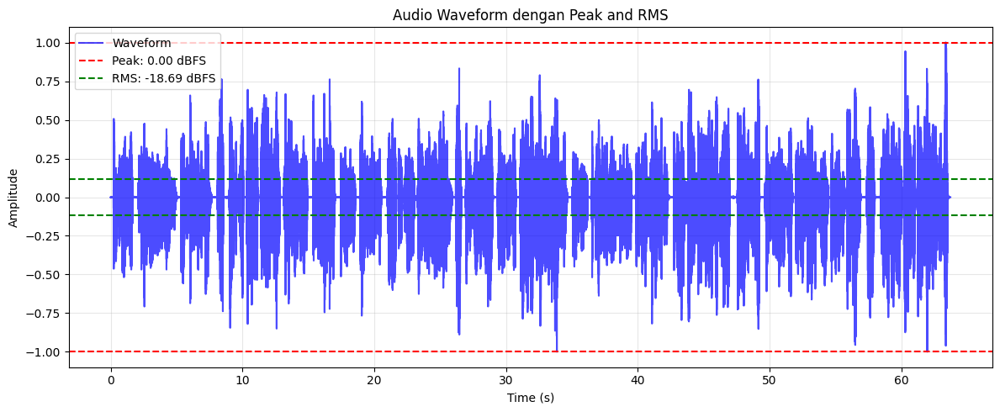

🔊 Audio Player:


In [ ]:
import numpy as np
import librosa, os

# Memuat Audio (sama dengan Week 1)
PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'audio.wav')

# Load audio dengan error handling
try:
    y, sr = librosa.load(PATH_AUDIO, sr=None)  # sr=None mempertahankan sample rate asli
    source_info = f"✅ Berhasil memuat: {PATH_AUDIO}"
except Exception as e:
    print(f"❌ Error loading audio: {e}")
    raise

# Konversi ke mono jika stereo
if y.ndim > 1:
    y = np.mean(y, axis=0)
    source_info += " - Dikonversi ke mono"

# Normalisasi dan konversi tipe data
y = y.astype(np.float32)

print("🎵 AUDIO LOADED")
print("=" * 40)
print(source_info)
print(f"📊 Shape: {y.shape}")
print(f"🎵 Sample rate: {sr:,} Hz")
print(f"⏱️ Durasi: {len(y)/sr:.2f} detik")
print(f"📈 Amplitude range: {y.min():.3f} to {y.max():.3f}")

# Normalisasi dan konversi tipe data
y = y.astype(np.float32)

# Hitung Nilai Peak (linear ke dBFS)
peak = np.max(np.abs(y))
peak_db = 20 * np.log10(peak)

# Hitung Nilai RMS (linear ke dBFS)
rms = np.sqrt(np.mean(y**2))
rms_db = 20 * np.log10(rms)

print("\n📏 Metrik Loudness:")
print(f"🔊 Peak: {peak:.3f} ({peak_db:.2f} dBFS)")
print(f"📈 RMS:  {rms:.3f} ({rms_db:.2f} dBFS)")

# Plot waveform dengan garis Peak dan RMS
plt.figure(figsize=(12, 5))
time = np.linspace(0, len(y) / sr, len(y))

plt.plot(time, y, label="Waveform", color='blue', alpha=0.7)
plt.axhline(peak, color='red', linestyle='--', label=f"Peak: {peak_db:.2f} dBFS")
plt.axhline(-peak, color='red', linestyle='--')
plt.axhline(rms, color='green', linestyle='--', label=f"RMS: {rms_db:.2f} dBFS")
plt.axhline(-rms, color='green', linestyle='--')
plt.title("Audio Waveform dengan Peak and RMS")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Audio player
print("🔊 Audio Player:")
display(Audio(y, rate=sr))

### LUFS dengan pyloudnorm

- LUFS (Loudness Units relative to Full Scale) adalah standar untuk mengukur kenyaringan audio sesuai persepsi manusia.  
- LUFS memperhitungkan sensitivitas telinga terhadap frekuensi tertentu dan durasi pendengaran.  

In [7]:
import pyloudnorm as pyln

# Meter untuk loudness
meter = pyln.Meter(sr)  # default K-weighting
lufs = meter.integrated_loudness(y)

print(f"LUFS (Integrated Loudness): {lufs:.2f} LUFS")

LUFS (Integrated Loudness): -19.04 LUFS


### Target Loudness Standar Industri

- **Broadcast (TV/Radio)**: rata-rata **-23 LUFS**  
- **Streaming (Spotify, YouTube, Apple Music)**: rata-rata **-14 LUFS**  

## Gain & Volume Control

Pengendalian gain dan volume memungkinkan kita menyesuaikan level audio, membuat transisi halus, dan menggabungkan beberapa klip secara konsisten.

### Adjusting Gain (dB / Linear)

- Gain bisa dinyatakan dalam **skala linear** (perkalian langsung dengan amplitudo) atau **skala dB**.  
- Rumus konversi:  
$$\text{linear} = 10^{\frac{\text{dB}}{20}}$$
- Contoh: menaikkan gain +6 dB ≈ menggandakan amplitudo sinyal.


✅ Gain applied: +8.0 dB (linear factor 1.995)

Loudness (Before → After):
  • Peak:   0.00 dBFS  →   0.00 dBFS
  • RMS : -18.69 dBFS  → -11.04 dBFS
  • LUFS: -19.04 LUFS  → -11.42 LUFS


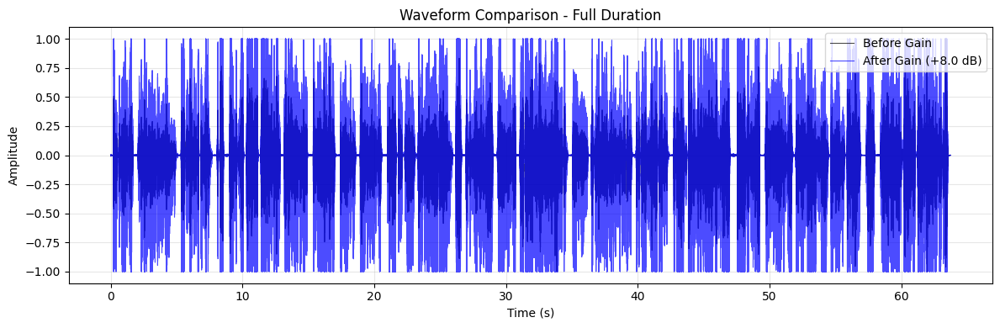

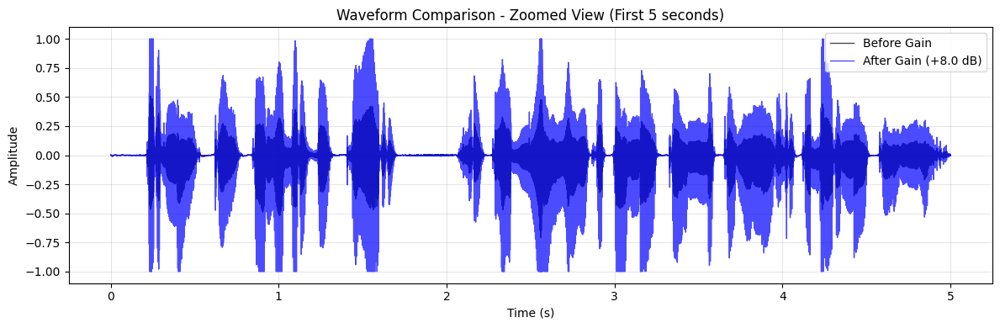


🔊 Audio Comparison:
🎵 BEFORE Gain Adjustment:



🎵 AFTER Gain Adjustment (+8.0 dB):


Perhatikan perubahan loudness pada audio setelah penyesuaian gain.


In [ ]:
import numpy as np
import librosa, os
import pyloudnorm as pyln
from IPython.display import Audio, display
import matplotlib.pyplot as plt

# Load audio
PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'audio.wav')
y, sr = librosa.load(PATH_AUDIO, sr=None)

# Helper: kalkulasi loudness
def peak_dbfs(sig):
    p = np.max(np.abs(sig))
    return p, 20*np.log10(p + 1e-12)

def rms_dbfs(sig):
    r = np.sqrt(np.mean(sig**2))
    return r, 20*np.log10(r + 1e-12)

def lufs_value(sig, sr):
    meter = pyln.Meter(sr)
    return meter.integrated_loudness(sig)

# Ukur Loudness sebelum gain
peak_val_before, peak_before_db = peak_dbfs(y)
rms_val_before, rms_before_db   = rms_dbfs(y)
lufs_before = lufs_value(y, sr)

# Fungsi Gain Adjustment
def adjust_gain(audio_data, gain_db=8.0):
    gain_linear = 10 ** (gain_db / 20.0)
    adjusted_audio = audio_data * gain_linear
    adjusted_audio = np.clip(adjusted_audio, -1.0, 1.0) # Clip to prevent amplitude overflow
    return adjusted_audio

gain_db = 8.0
y_gain = adjust_gain(y, gain_db)   

# Ukur Loudness sesudah gain
peak_val_after, peak_after_db = peak_dbfs(y_gain)
rms_val_after, rms_after_db   = rms_dbfs(y_gain)
lufs_after = lufs_value(y_gain, sr)

# Print ringkas
print(f"✅ Gain applied: {gain_db:+.1f} dB (linear factor {gain_linear:.3f})\n")
print("Loudness (Before → After):")
print(f"  • Peak: {peak_before_db:6.2f} dBFS  → {peak_after_db:6.2f} dBFS")
print(f"  • RMS : {rms_before_db:6.2f} dBFS  → {rms_after_db:6.2f} dBFS")
print(f"  • LUFS: {lufs_before:6.2f} LUFS  → {lufs_after:6.2f} LUFS")

# Plot perbandingan waveform - durasi penuh
t_full = np.linspace(0, len(y)/sr, len(y), endpoint=False)

plt.figure(figsize=(12, 4))
plt.plot(t_full, y, label="Before Gain", color="black", alpha=0.7, linewidth=0.8)
plt.plot(t_full, y_gain, label=f"After Gain ({gain_db:+.1f} dB)", color="blue", alpha=0.7, linewidth=0.8)

# Labels
plt.title("Waveform Comparison - Full Duration")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.grid(True, alpha=0.3)
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()

# Plot zoomed view - first 5 seconds
duration_zoom = 5.0
samples_zoom = int(duration_zoom * sr)
t_zoom = np.linspace(0, duration_zoom, samples_zoom)

plt.figure(figsize=(12, 4))
plt.plot(t_zoom, y[:samples_zoom], label="Before Gain", color="black", alpha=0.7, linewidth=1.0)
plt.plot(t_zoom, y_gain[:samples_zoom], label=f"After Gain ({gain_db:+.1f} dB)", color="blue", alpha=0.7, linewidth=1.0)

plt.title("Waveform Comparison - Zoomed View (First 5 seconds)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.grid(True, alpha=0.3)
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()

# Display audio players for comparison
print("\n🔊 Audio Comparison:")
print("=" * 40)

print("🎵 BEFORE Gain Adjustment:")
display(Audio(y, rate=sr))

print(f"\n🎵 AFTER Gain Adjustment (+{gain_db} dB):")
display(Audio(y_gain, rate=sr))

print("Perhatikan perubahan loudness pada audio setelah penyesuaian gain.")

### Fade In & Fade Out

- **Fade In**: meningkatkan volume perlahan dari 0 hingga normal.  
- **Fade Out**: menurunkan volume perlahan hingga senyap.  
- Bisa berbentuk **linear** atau **eksponensial** untuk hasil berbeda.

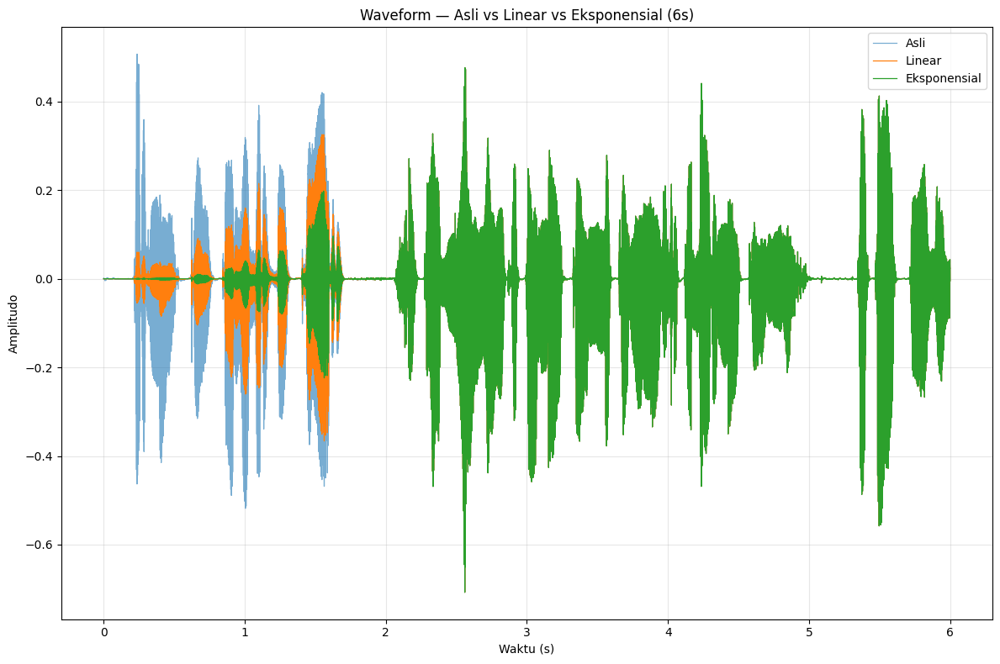

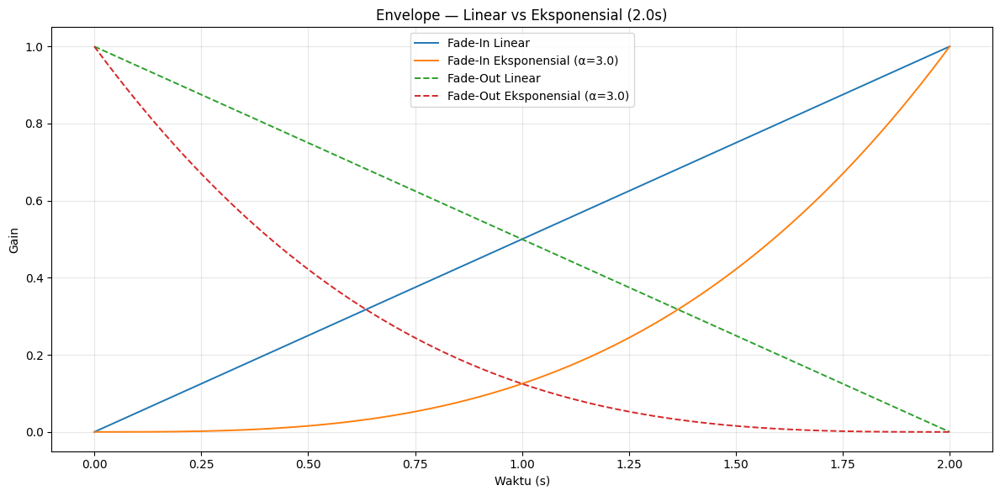

🔊 Audio Comparison:
🎵 Original Audio:
   Audio asli tanpa efek fade



🎵 Linear Fade:
   Fade in/out linear 2000ms - transisi volume konstan



🎵 Exponential Fade:
   Fade in/out eksponensial 2000ms (α=3.0) - transisi natural


In [ ]:
import os, numpy as np, librosa, matplotlib.pyplot as plt
from IPython.display import Audio, display

PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'audio.wav')
y, sr = librosa.load(PATH_AUDIO, sr=None)

def linear_fade(audio, sr, ms=2000):
    N = min(int(ms/1000 * sr), len(audio)//2)
    fin  = np.linspace(0.0, 1.0, N)
    fout = np.linspace(1.0, 0.0, N)
    out = audio.copy()
    out[:N]  *= fin
    out[-N:] *= fout
    return out, fin, fout, N

"""
Membuat fade in/out eksponensial pada audio.

Parameter alpha mengontrol kurva fade:
- alpha = 1.0: fade linear (sama dengan linear_fade)
- alpha > 1.0: fade lebih cepat di awal, lebih lambat di akhir (fade in yang natural)
- alpha < 1.0: fade lebih lambat di awal, lebih cepat di akhir (fade out yang natural)
- Nilai umum: alpha = 2.0-4.0 untuk hasil yang terdengar natural
"""
def exp_fade(audio, sr, ms=2000, alpha=3.0):
    N = min(int(ms/1000 * sr), len(audio)//2)
    x = np.linspace(0.0, 1.0, N)
    fin  = x**alpha
    fout = (1.0 - x)**alpha
    out = audio.copy()
    out[:N]  *= fin
    out[-N:] *= fout
    return out, fin, fout, N, alpha

fade_ms = 2000
y_lin, fin_lin, fout_lin, N_lin = linear_fade(y, sr, fade_ms)
y_exp, fin_exp, fout_exp, N_exp, alpha = exp_fade(y, sr, fade_ms, alpha=3.0)

L = min(len(y), int(sr * 6.0))
t = np.linspace(0, L/sr, L, endpoint=False)

plt.figure(figsize=(12, 8))
plt.plot(t, y[:L],     label="Asli", linewidth=0.9, alpha=0.6)
plt.plot(t, y_lin[:L], label="Linear", linewidth=0.9)
plt.plot(t, y_exp[:L], label="Eksponensial", linewidth=0.9)
plt.title("Waveform — Asli vs Linear vs Eksponensial (6s)")
plt.xlabel("Waktu (s)")
plt.ylabel("Amplitudo")
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

N = min(N_lin, N_exp)
t_env = np.arange(N)/sr

plt.figure(figsize=(12, 6))
plt.plot(t_env, fin_lin[:N],  label="Fade-In Linear", linewidth=1.4)
plt.plot(t_env, fin_exp[:N],  label=f"Fade-In Eksponensial (α={alpha})", linewidth=1.4)
plt.plot(t_env, fout_lin[:N], label="Fade-Out Linear", linestyle="--", linewidth=1.4)
plt.plot(t_env, fout_exp[:N], label=f"Fade-Out Eksponensial (α={alpha})", linestyle="--", linewidth=1.4)
plt.title(f"Envelope — Linear vs Eksponensial ({fade_ms/1000:.1f}s)")
plt.xlabel("Waktu (s)")
plt.ylabel("Gain")
plt.ylim(-0.05, 1.05)
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

print("🔊 Audio Comparison:")
print("=" * 40)

print("🎵 Original Audio:")
print("   Audio asli tanpa efek fade")
display(Audio(y, rate=sr))

print("\n🎵 Linear Fade:")
print(f"   Fade in/out linear {fade_ms}ms")
display(Audio(y_lin, rate=sr))

print("\n🎵 Exponential Fade:")
print(f"   Fade in/out eksponensial {fade_ms}ms (α={alpha})")
display(Audio(y_exp, rate=sr))


### Crossfades

- **Crossfade** menyatukan dua klip dengan tumpang tindih halus.  
- Volume klip pertama diturunkan, klip kedua dinaikkan, sehingga transisi terdengar halus.  

In [20]:
import os, numpy as np, librosa, matplotlib.pyplot as plt
from IPython.display import Audio, display

# load dua file
PATH_A = os.path.join(os.getcwd(), 'data', 'audio.wav')
PATH_B = os.path.join(os.getcwd(), 'data', 'artorias.wav')
a, sr_a = librosa.load(PATH_A, sr=None)
b, sr_b = librosa.load(PATH_B, sr=None)

# samakan sample rate
if sr_b != sr_a:
    b = librosa.resample(b, orig_sr=sr_b, target_sr=sr_a)
    sr_b = sr_a
sr = sr_a

def crossfade_two(a: np.ndarray, b: np.ndarray, sr: int, dur_sec: float = 1.0):
    N = min(int(dur_sec * sr), len(a), len(b))
    fade_out_a = np.linspace(1.0, 0.0, N)
    fade_in_b = np.linspace(0.0, 1.0, N)
    result = np.concatenate([a[:-N], a[-N:] * fade_out_a + b[:N] * fade_in_b, b[N:]])
    return result, fade_out_a, fade_in_b, N

y_cross, fade_out, fade_in, N = crossfade_two(a, b, sr, dur_sec=1.0)

# Print timing information
start_time_a = (len(a) - N) / sr
end_time_a = len(a) / sr
print(f"\n⏱️ Crossfade Timing Information:")
print(f"   • Crossfade duration: {N/sr:.2f} seconds ({N:,} samples)")
print(f"   • Crossfade Time: {start_time_a:.2f}s - {end_time_a:.2f}s")
print(f"   • Total result length: {len(y_cross)/sr:.2f}s")

print("\n🎵 Crossfaded Result:")
display(Audio(y_cross, rate=sr))


⏱️ Crossfade Timing Information:
   • Crossfade duration: 1.00 seconds (24,000 samples)
   • Crossfade Time: 62.73s - 63.73s
   • Total result length: 102.20s

🎵 Crossfaded Result:
